In [1]:
import numpy as np
import cv2
import os
import yaml
import pickle
from glob import glob
import matplotlib.pyplot as plt

In [3]:
#make matplotlib figures appear inline in the notebook
#rather than in a new window.
%matplotlib inline
# set default size of plots
plt.rcParams['figure.figsize'] = (12.0, 10.0) 
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

#print OpenCV version
print ("OpenCV Version : %s " % cv2.__version__)

OpenCV Version : 3.3.1 


In [4]:
# the notebook will reload external python modules;
%load_ext autoreload
%autoreload 2

In [5]:
#source video
video_capture = cv2.VideoCapture('../data/DJI00957.MP4')

In [6]:
#chessboard pattern
pattern_size = (9, 6) #number of points
pattern_points = np.zeros((np.prod(pattern_size), 3), np.float32)
pattern_points[:, :2] = np.indices(pattern_size).T.reshape(-1, 2)

In [8]:
#initializing
frame_step = 20 #read at each 'frame_step' frames
obj_points = []
img_points = []
h, w = 0, 0
i = -1
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_COUNT, 30, 0.001)
retval = True

In [9]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*7,3), np.float32)
objp[:,:2] = np.mgrid[0:7,0:6].T.reshape(-1,2)

Searching for chessboard in frame 0...
ok


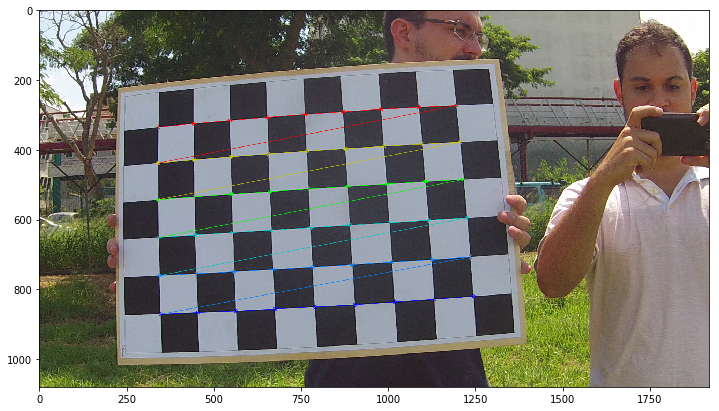

Searching for chessboard in frame 20...
ok


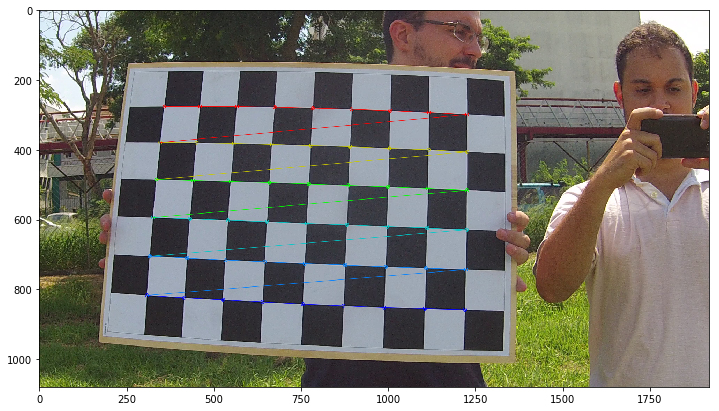

Searching for chessboard in frame 40...
ok


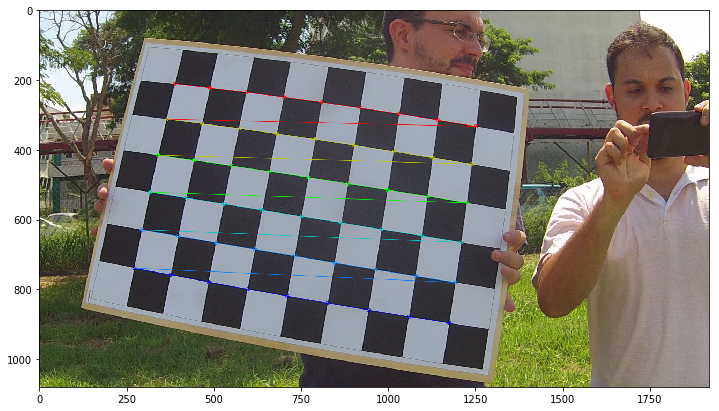

Searching for chessboard in frame 60...
ok


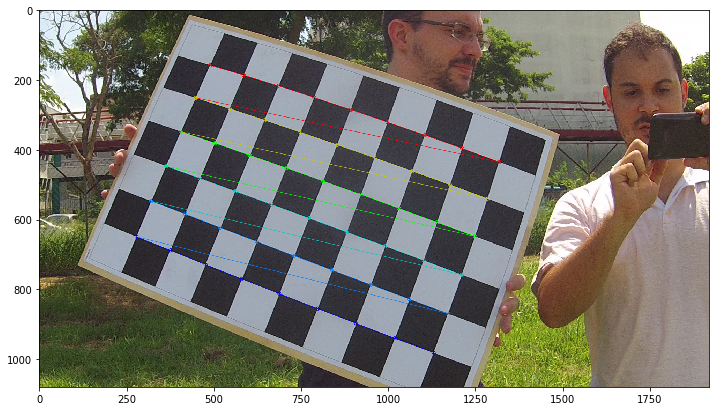

Searching for chessboard in frame 80...
ok


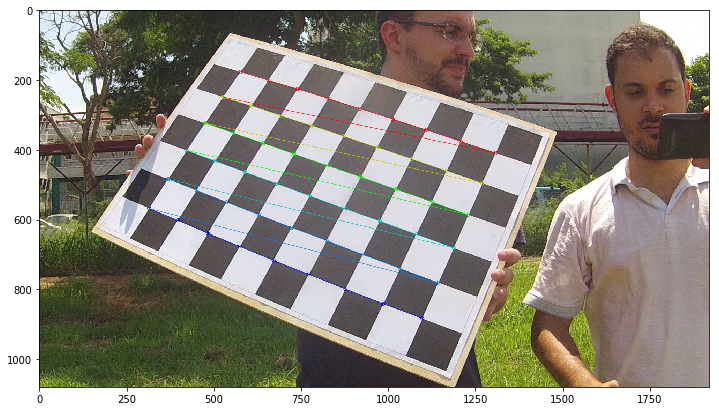

Searching for chessboard in frame 100...
ok


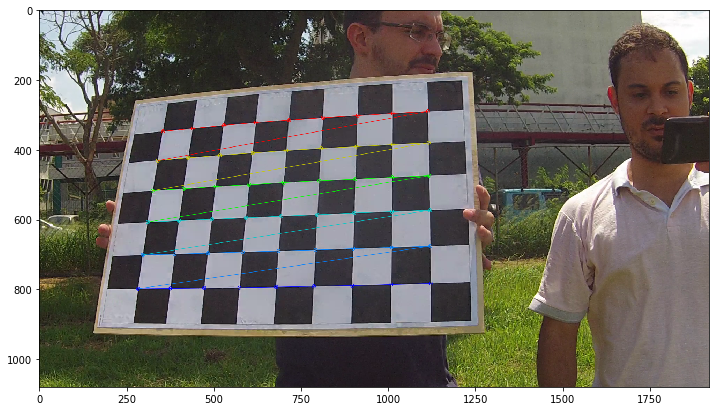

Searching for chessboard in frame 120...
ok


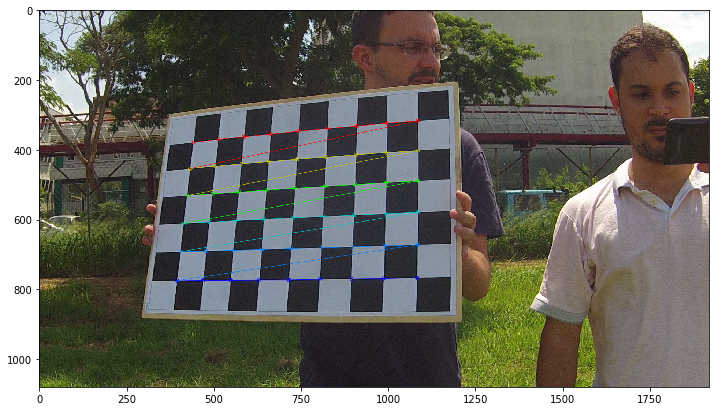

Searching for chessboard in frame 140...
ok


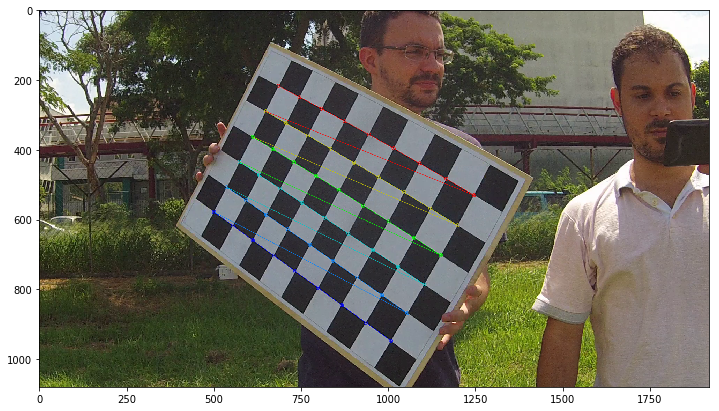

Searching for chessboard in frame 160...
ok


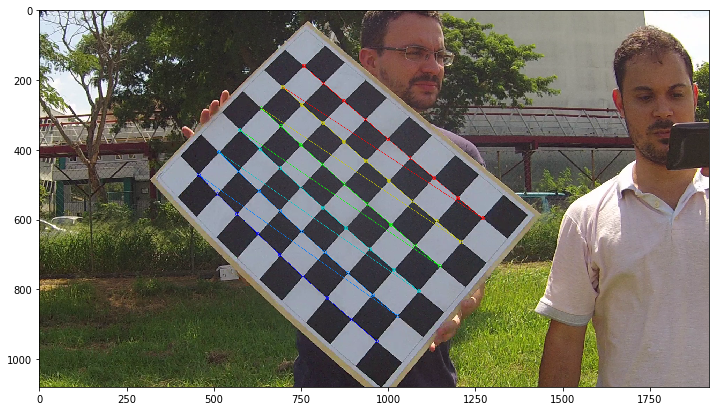

Searching for chessboard in frame 180...
ok


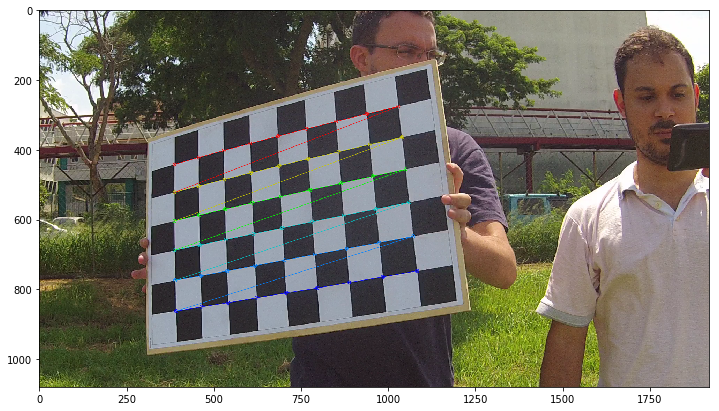

Searching for chessboard in frame 200...
ok


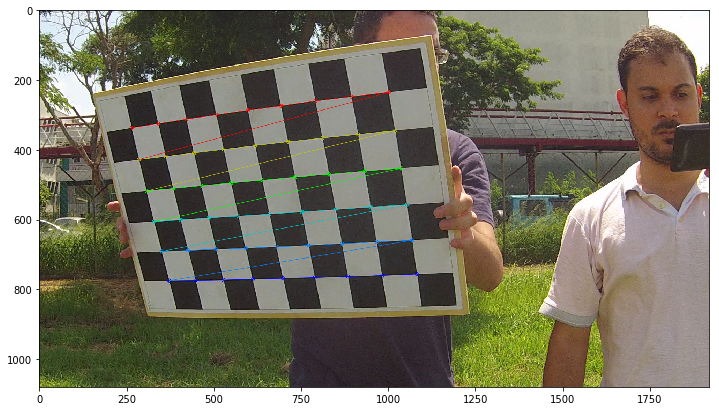

Searching for chessboard in frame 220...
ok


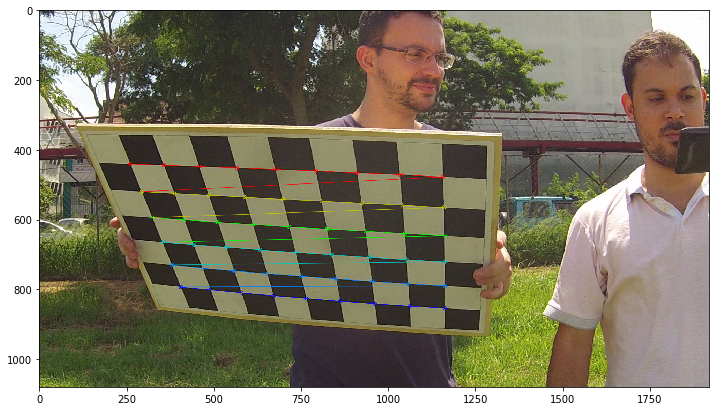

Searching for chessboard in frame 240...
ok


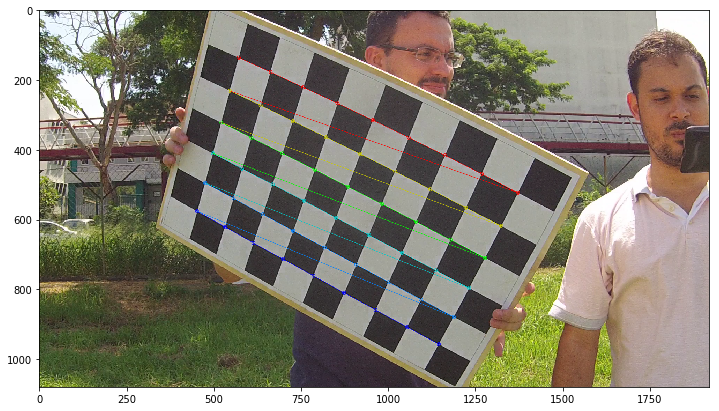

Searching for chessboard in frame 260...
ok


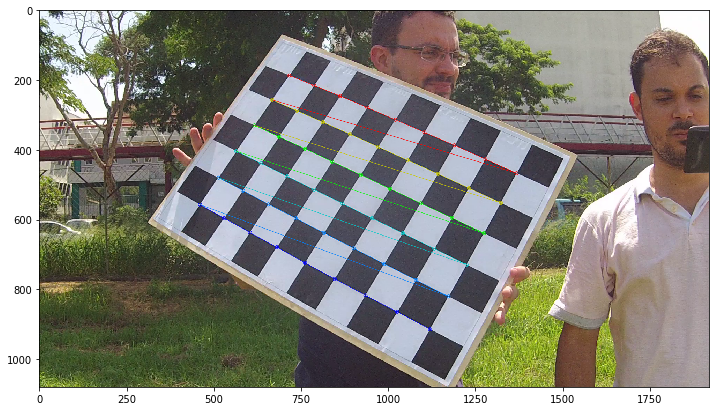

Searching for chessboard in frame 280...
not found
Searching for chessboard in frame 300...
ok


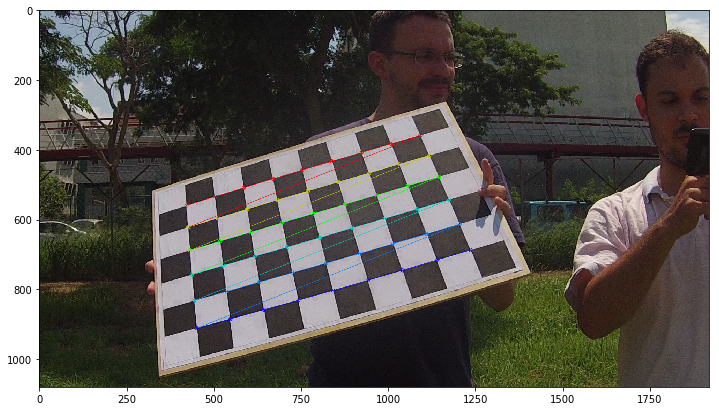

Searching for chessboard in frame 320...
ok


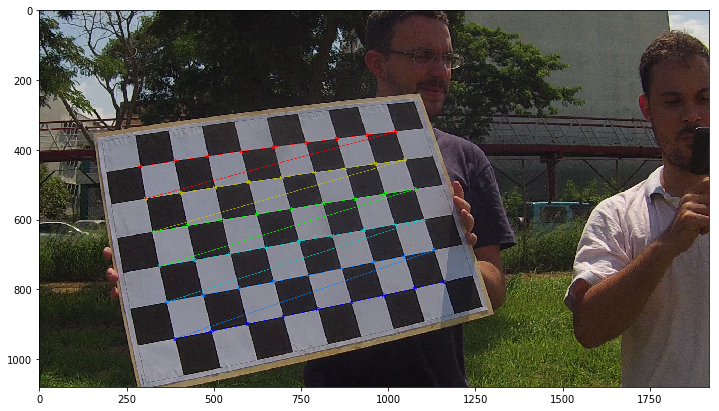

Searching for chessboard in frame 340...
ok


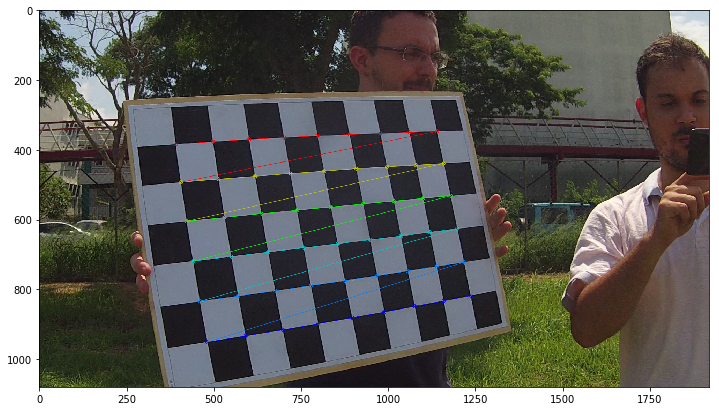

Searching for chessboard in frame 360...
ok


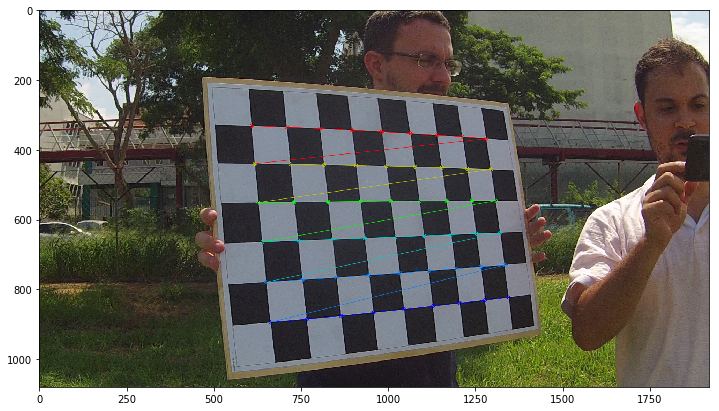

Searching for chessboard in frame 380...
ok


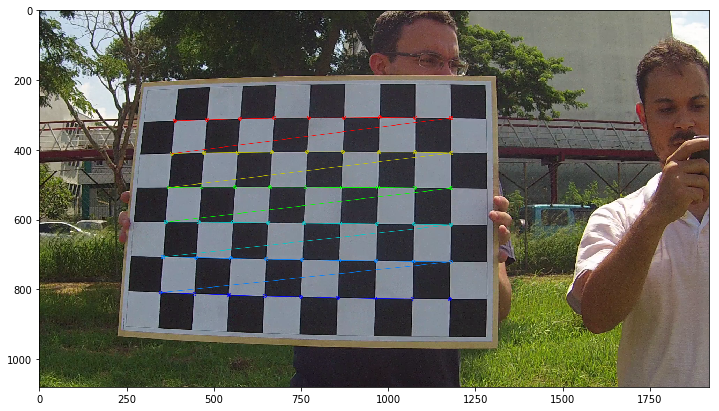

Searching for chessboard in frame 400...
ok


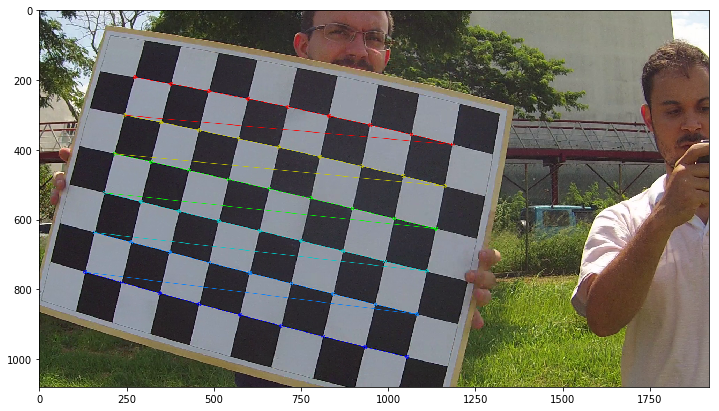

Searching for chessboard in frame 420...
not found
Searching for chessboard in frame 440...
ok


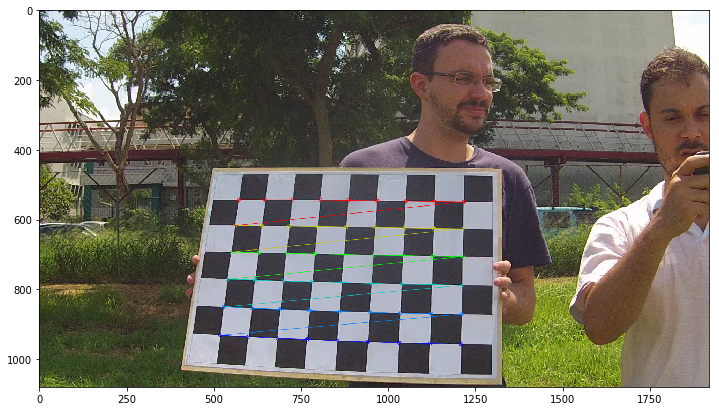

Searching for chessboard in frame 460...
ok


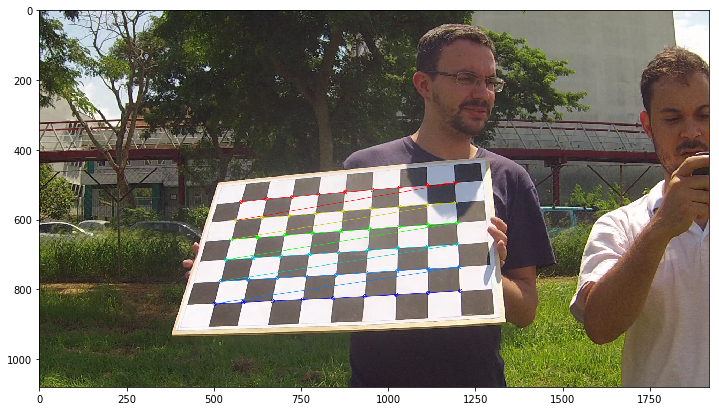

Searching for chessboard in frame 480...
ok


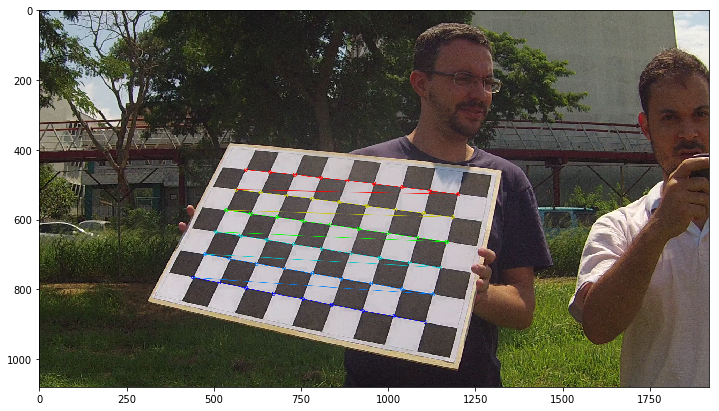

Searching for chessboard in frame 500...
ok


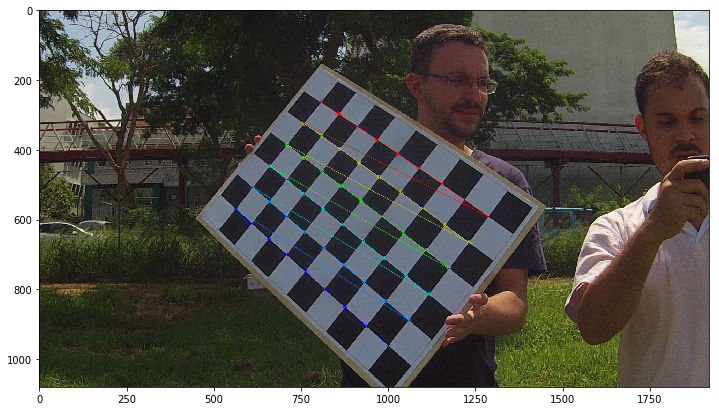

Searching for chessboard in frame 520...
ok


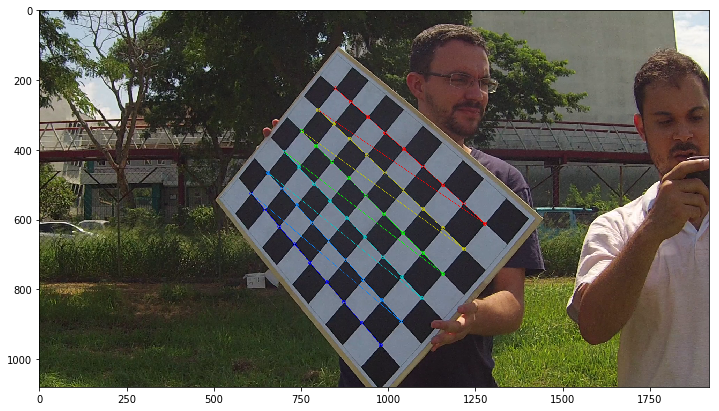

Searching for chessboard in frame 540...
ok


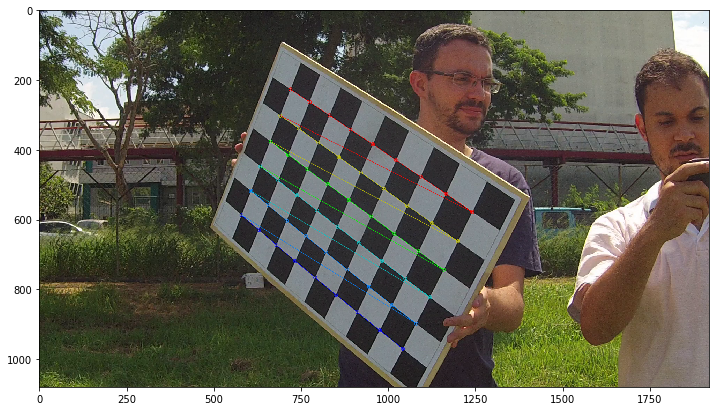

Searching for chessboard in frame 560...
ok


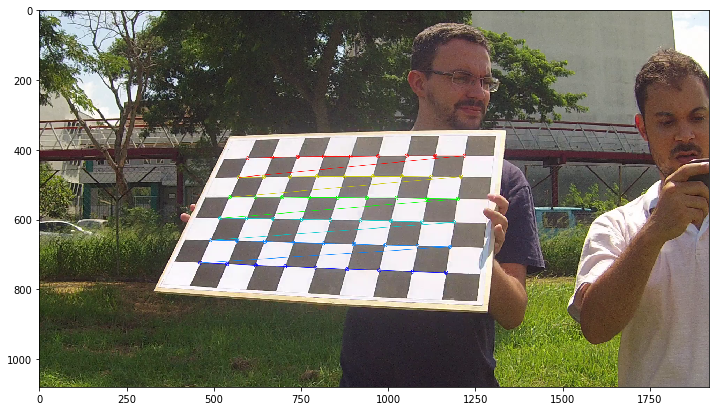

Searching for chessboard in frame 580...
ok


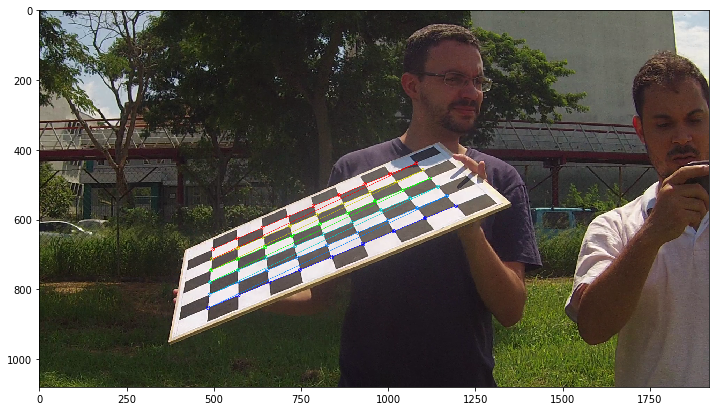

video capture failed!


In [10]:
while retval:
    i+=1
    
    #extracting frame
    retval, img = video_capture.read()
    if not retval:
        print('video capture failed!')
        break
    
    #read at each frame_step    
    if i % frame_step != 0:
        continue
        
    print('Searching for chessboard in frame ' + str(i) + '...')
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) 
    h, w = img.shape[:2]
    
    #Find chessboard corners
    found, corners = cv2.findChessboardCorners(gray, pattern_size, cv2.CALIB_CB_FILTER_QUADS)
    
    # If found, add object points, image points (after refining them)
    if found:        
        corners2 = cv2.cornerSubPix(gray, corners, (11, 11), (-1, -1), criteria)
    
    #If not found, go to next frame
    if not found:
        print('not found')
        continue
    
    img_points.append(corners2)
    obj_points.append(pattern_points)
    
    print('ok')
    
    # Draw and display the corners
    img = cv2.drawChessboardCorners(cv2.cvtColor(img,cv2.COLOR_BGR2RGB), pattern_size, corners2,found)
    plt.imshow(img)
    plt.show()        

## Calibration

In [11]:
print('\nPerforming calibration...')
rms, camera_matrix, dist_coefs, rvecs, tvecs = cv2.calibrateCamera(obj_points, img_points, (w, h), None, None)
camera_matrix


Performing calibration...


array([[2.06785396e+03, 0.00000000e+00, 8.39057175e+02],
       [0.00000000e+00, 2.07891787e+03, 5.86128742e+02],
       [0.00000000e+00, 0.00000000e+00, 1.00000000e+00]])

## Undistortion

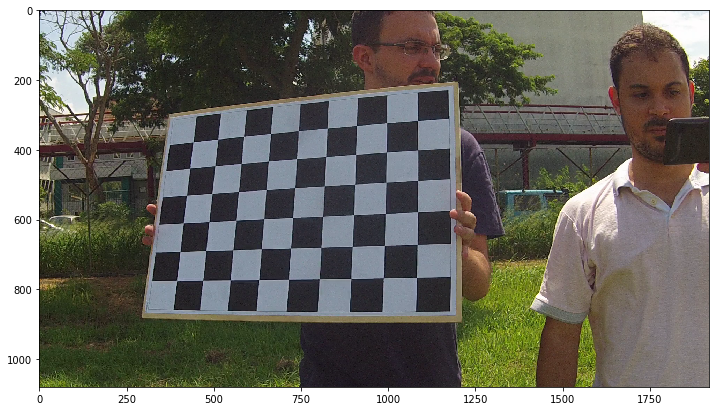

In [14]:
# http://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_calib3d/py_calibration/py_calibration.html
#choosing a frame at random
img = cv2.imread('../data/frames_DJI00957/frame120.png')
h,  w = img.shape[:2]
#define the camera matrix based on a free scaling parameter using cv2.getOptimalNewCameraMatrix()
new_camera_matrix, roi=cv2.getOptimalNewCameraMatrix(camera_matrix,dist_coefs,(w,h),1,(w,h))
#display image
plt.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))
plt.show() 

* Using cv2.undistort()

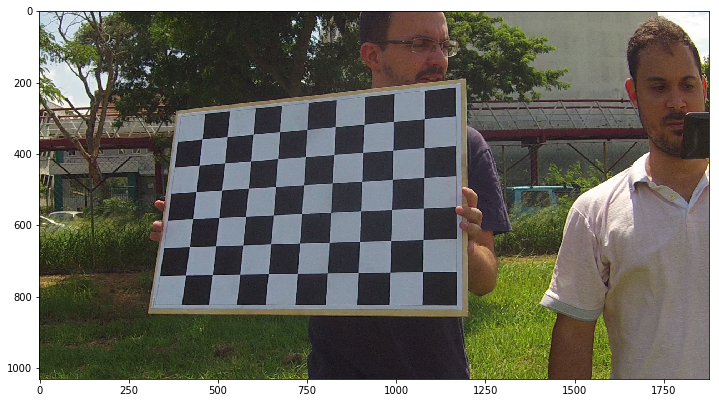

In [17]:
# undistort
dst = cv2.undistort(img, camera_matrix, dist_coefs, None, new_camera_matrix)

# crop the image
x,y,w,h = roi
dst = dst[y:y+h, x:x+w, :]
#display image
plt.imshow(cv2.cvtColor(dst,cv2.COLOR_BGR2RGB))
plt.show() 

uh-oh! something seems wrong here!

* Using remapping

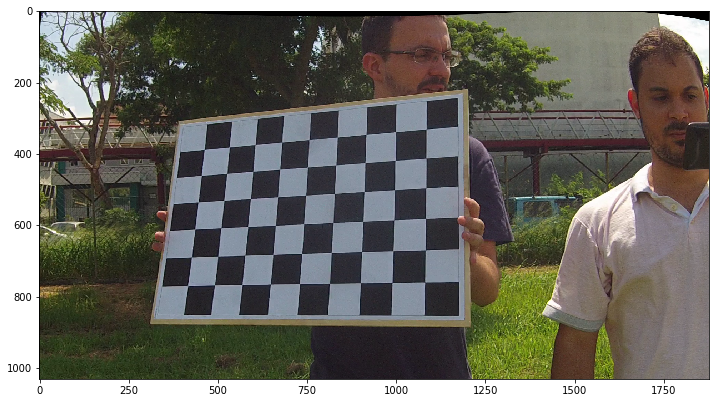

In [25]:
# undistort
mapx,mapy = cv2.initUndistortRectifyMap(camera_matrix,dist_coefs,None,new_camera_matrix,(w,h),5)
dst = cv2.remap(img,mapx,mapy,cv2.INTER_LINEAR)

# crop the image
x,y,w,h = roi
#dst = dst[y:y+h, x:x+w]
#display image
plt.imshow(cv2.cvtColor(dst,cv2.COLOR_BGR2RGB))
plt.show() 

In [26]:
cv2.addWeighted(img,0.5,dst,0.5,0)

error: /tmp/build/80754af9/opencv_1512687413662/work/modules/core/src/arithm.cpp:659: error: (-209) The operation is neither 'array op array' (where arrays have the same size and the same number of channels), nor 'array op scalar', nor 'scalar op array' in function arithm_op
